<a href="https://colab.research.google.com/github/harshaharod21/Natural-Language-Processing/blob/main/Bank_review_Text_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Text Analysis of Customer Reviews of Bank

**Objective:** To understand the relation between rating and customer review.  

**Dataset:** The dataset is accessed from HuggingFace Datasets for text classification.

The dataset contains
* Author Name,
* Date,
* Location,
* Name of Bank,
* Rating,
* Text Review,
* Likes

Link to the dataset access: https://huggingface.co/datasets/TrainingDataPro/customers-reviews-on-banks

**Content of Notebook:**

* Exploratory Data Analysis
* Frequent word for negative Review
* Topic Modeling using LDA
* Analysing influential Author's Review
* Using TF-Idf method, NER Model, Bertopic Topic Modeling




In [2]:
# Importing Libraries

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


In [ ]:
#To access the dataset from HuggingFace dataset we install datasets

! pip install datasets

In [4]:

from datasets import load_dataset

In [5]:
import numpy as np


In [6]:
data= load_dataset('TrainingDataPro/customers-reviews-on-banks')

In [ ]:
data

DatasetDict({
    train: Dataset({
        features: ['author', 'date', 'location', 'bank', 'star', 'text', 'like'],
        num_rows: 19271
    })
})

In [8]:
data_tr= load_dataset('TrainingDataPro/customers-reviews-on-banks', split='train')

In [110]:
# Sample observation
data_tr[3908]

{'author': 'Mark',
 'date': '21.01.2017',
 'location': 'Sioux Falls, SD',
 'bank': 'state_farm_bank',
 'star': 1,
 'text': 'I have my loan through State Farm. I have been paying my loan each month. I received a notice that I was 3 months behind. They told me I missed a payment in December 2015. I had took their offer to not make a payment for Christmas that month. They are now telling me that due to that they have applied each of my payments to the past month. Now they say they will repossess my vehicle.',
 'like': 20.0}

## Exploratory Data Analysis

In [ ]:
data_tr.shape

(19271, 7)

**Frequency of Observation based on Banks**

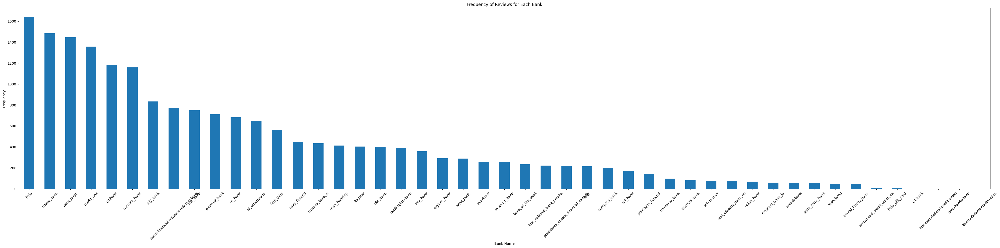

In [9]:
dataset_df = pd.DataFrame(data_tr)

# Assuming 'name_of_bank' is the column name containing the names of the banks
bank_frequency = dataset_df['bank'].value_counts()

# Plotting
plt.figure(figsize=(40, 10))
bank_frequency.plot(kind='bar')
plt.title('Frequency of Reviews for Each Bank')
plt.xlabel('Bank Name')
plt.ylabel('Frequency')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.tight_layout()  # Adjust layout to prevent label cutoff
plt.show()

**Rating Distribution for All Observation**

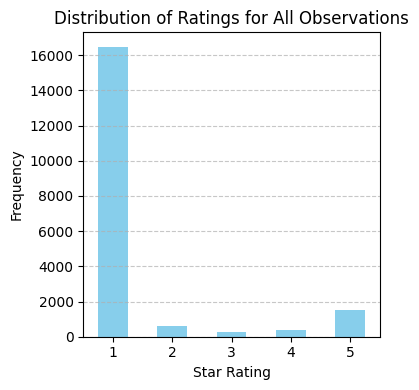

In [ ]:
ratings_distribution = dataset_df['star'].value_counts().sort_index()

# Plotting
plt.figure(figsize=(4, 4))
ratings_distribution.plot(kind='bar', color='skyblue')
plt.title('Distribution of Ratings for All Observations')
plt.xlabel('Star Rating')
plt.ylabel('Frequency')
plt.xticks(rotation=0)  # Rotate x-axis labels if necessary
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

**Rating Distribution specific to Bank**

<ipython-input-25-130e45806e87>:12: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['1', '2', '3', '4', '5'])


<Figure size 1400x1000 with 0 Axes>

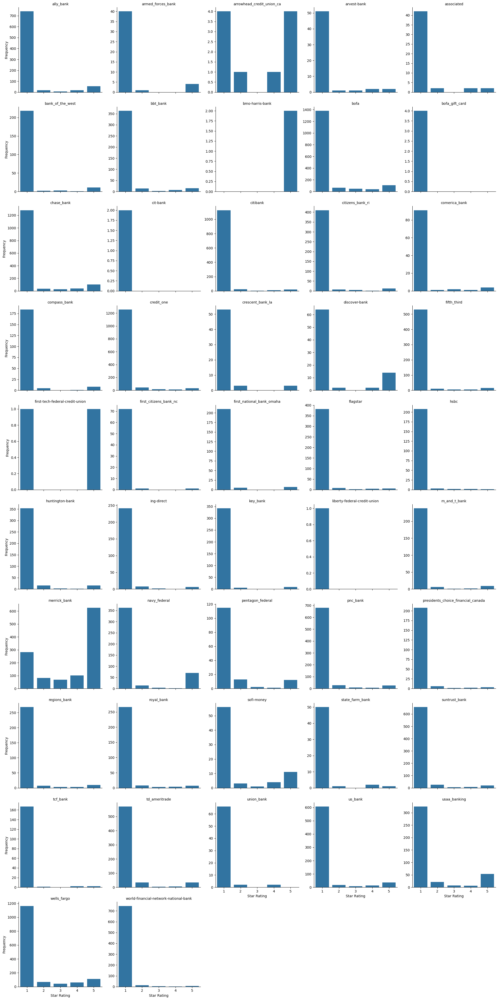

In [ ]:
bank_rating_data = dataset_df.groupby(['bank', 'star']).size().reset_index(name='count')

plt.figure(figsize=(14, 10))

# Use seaborn's FacetGrid to create a faceted plot
g = sns.FacetGrid(bank_rating_data, col="bank", col_wrap=5, height=4, sharey=False)
g.map(sns.barplot, "star", "count", order=[1, 2, 3, 4, 5])
g.set_titles("{col_name}")
g.set_axis_labels("Star Rating", "Frequency")

for ax in g.axes.flat:
    ax.set_xticklabels(['1', '2', '3', '4', '5'])

plt.tight_layout()  # Adjust layout to prevent label cutoff
plt.show()

**Based on Location**

In [ ]:
location_distribution = dataset_df['location'].value_counts()

# Plotting
plt.figure(figsize=(10, 6))
location_distribution.plot(kind='bar', color='skyblue')
plt.title('Distribution of Locations for All Observations')
plt.xlabel('Location')
plt.ylabel('Frequency')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.tight_layout()
plt.show()


**Distribution of Likes**

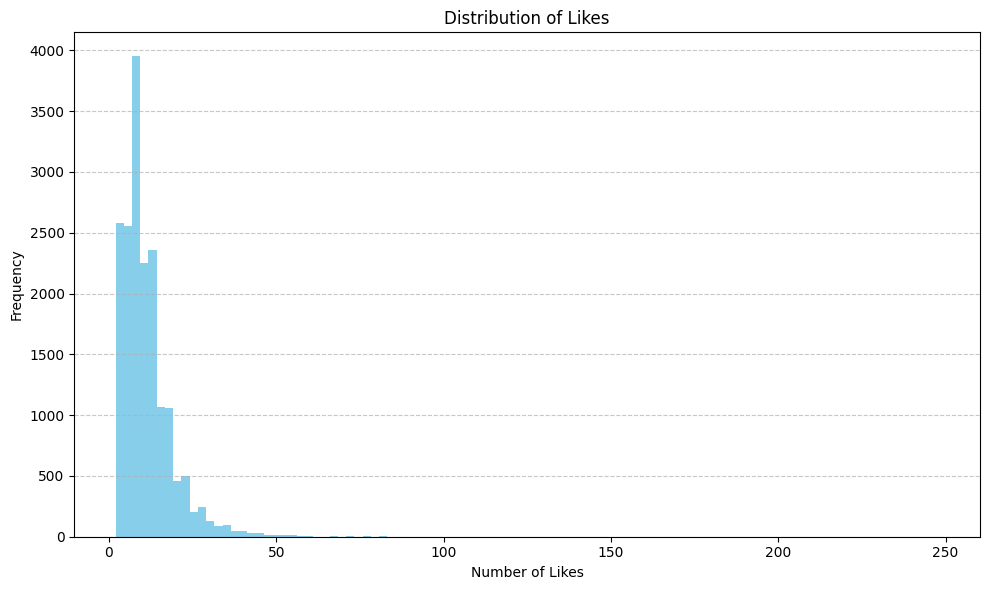

In [ ]:
plt.figure(figsize=(10, 6))
plt.hist(dataset_df['like'], bins=100, color='skyblue')
plt.title('Distribution of Likes')
plt.xlabel('Number of Likes')
plt.ylabel('Frequency')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

### Insights from EDA


*   We can observe that rating from all observation is dominated mostly by **negative reviews** across all the banks.
*   We can focus on the negative reviews to identify which **product or service** are customers mostly complainting about.
* The major distribution of number of likes ranges from 0 to 50. Analysiing the text reviews for most number of likes will provide the keywords used by the most influential author.



### Frequent Word for Negative Review

In [ ]:
pip install tabulate

In [20]:
import nltk
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [21]:
import nltk
nltk.download('wordnet')


[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [22]:
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [23]:
from nltk.corpus import stopwords
from nltk.tokenize import sent_tokenize

In [ ]:
import re

In [ ]:
reviews_rating_1_2 = dataset_df.loc[(dataset_df['star'] == 1) | (dataset_df['star'] == 2), 'text'].dropna()

In [ ]:
reviews_rating_1_2_joined = ' '.join(reviews_rating_1_2.tolist())

In [ ]:
tokens = nltk.word_tokenize(reviews_rating_1_2_joined)

In [ ]:
filtered_tokens = [word for word in tokens if word.lower() not in set(stopwords.words('english'))]

In [ ]:
reviews_rating_1_2_filtered = ' '.join(filtered_tokens)

In [ ]:
special_chars_pattern = re.compile(r'[^a-zA-Z\s]')

# Remove special characters from the filtered text
reviews_rating_1_2_filtered_cleaned = special_chars_pattern.sub('', reviews_rating_1_2_filtered)


In [102]:
reviews_rating_1_2_filtered_cleaned

'called find charges bill  make  angry  transfer agent  put hold told wait next available agent   mins waited  mins  time hung without talking anyone  promised double credit amount   made time payment  requested increase got   increase  limit    false promise reason signed  called  autopay glitched  pull account like supposed  made time payment months  got   increase  double   poor experience especially  paid time used card  Also would get rid late payment  Even though issue system  Every time try make payment card takes money puts right back account shows nt paid  make payments early every month nt show make company  nt like especially brings credit score  like ease bill easy pay online appreciate credit line increases  HATE dealing overseas call centers customer service  nt understand guys use US BASED call centers first started guys s talk told guys opened overseas call centers instead option never done  nt understand frustrates US BASED call center worked great made company stand t

In [ ]:
corpus = []
for i in range(0, len(reviews_rating_1_2_filtered)):
    review = re.sub('[^a-zA-Z]', ' ', reviews_rating_1_2_filtered[i])
    review = review.lower()
    review = review.split()
    review = ' '.join(review)
    corpus.append(review)

In [ ]:
from collections import Counter
import nltk
from nltk import ngrams
from tabulate import tabulate


def frequent_words(reviews, n=20, ngram=1):
    tokens = nltk.word_tokenize(reviews.lower())
    if ngram == 1:
        grams = tokens
    elif ngram == 2:
        grams = list(ngrams(tokens, 2))
    elif ngram == 3:
        grams = list(ngrams(tokens, 3))
    elif ngram == 4:
        grams = list(ngrams(tokens, 4))

    freq_dist = Counter(grams)
    top_n = freq_dist.most_common(n)
    return top_n

# Filter dataset for ratings 1 and 2
#reviews_rating_1_2 = ' '.join(review['text'] for review in dataset_df if review['star'] in [1, 2])

# Get the most frequent words, bi-grams, and tri-grams for ratings 1 and 2
top_words = frequent_words(reviews_rating_1_2_filtered_cleaned, n=20, ngram=1)
top_bi_grams = frequent_words(reviews_rating_1_2_filtered_cleaned, n=20, ngram=2)
top_tri_grams = frequent_words(reviews_rating_1_2_filtered_cleaned, n=20, ngram=3)
top_quad_grams= frequent_words(reviews_rating_1_2_filtered_cleaned, n=20, ngram=4)

# Convert the results into a presentable table format
top_words_table = tabulate(top_words, headers=['Word', 'Frequency'], tablefmt='grid')
top_bi_grams_table = tabulate(top_bi_grams, headers=['Bi-gram', 'Frequency'], tablefmt='grid')
top_tri_grams_table = tabulate(top_tri_grams, headers=['Tri-gram', 'Frequency'], tablefmt='grid')
top_quad_grams_table = tabulate(top_quad_grams, headers=['Tri-gram', 'Frequency'], tablefmt='grid')

# Print the tables
print("Top 10 frequent words for ratings 1 and 2:")
print(top_words_table)
print("\nTop 10 frequent bi-grams for ratings 1 and 2:")
print(top_bi_grams_table)
print("\nTop 10 frequent tri-grams for ratings 1 and 2:")
print(top_tri_grams_table)
print("\nTop 10 frequent quad-grams for ratings 1 and 2:")
print(top_quad_grams_table)


Top 10 frequent words for ratings 1 and 2:
+----------+-------------+
| Word     |   Frequency |
+==========+=============+
| account  |       18868 |
+----------+-------------+
| bank     |       17248 |
+----------+-------------+
| card     |        9858 |
+----------+-------------+
| nt       |        9430 |
+----------+-------------+
| credit   |        8530 |
+----------+-------------+
| money    |        7449 |
+----------+-------------+
| would    |        6926 |
+----------+-------------+
| customer |        6826 |
+----------+-------------+
| get      |        6367 |
+----------+-------------+
| service  |        5854 |
+----------+-------------+
| told     |        5707 |
+----------+-------------+
| payment  |        5571 |
+----------+-------------+
| one      |        5546 |
+----------+-------------+
| time     |        5526 |
+----------+-------------+
| called   |        5353 |
+----------+-------------+
| never    |        5327 |
+----------+-------------+
| s        |

### Insights

Here we are focusing on the terms that indicate most frequent complains, so the bank can understand quickly and improve the areas of pain to the large segment of customer at first.

*   In general we can observe the frequency of word combination for the negative reviews indicates most of the complaints are regarding customer service through calls
*   The other most frequent word is for 'credit card' and 'debit card'
*  Crtical phrases noticed are for' consumer financial protection bureau'

We can further apply other techniques to understand more about the customer behaviour and their queries regarding product and services of each bank



## Topic Modeling using LDA
Latent Dirichlet allocation (LDA) is a Bayesian network (and, therefore, a generative statistical model) for modeling automatically extracted topics in textual corpora.

In [ ]:
import gensim

In [ ]:
tokens = nltk.word_tokenize(reviews_rating_1_2_filtered_cleaned)

In [ ]:
reviews_rating_1_2_filtered_cleaned

'called find charges bill  make  angry  transfer agent  put hold told wait next available agent   mins waited  mins  time hung without talking anyone  promised double credit amount   made time payment  requested increase got   increase  limit    false promise reason signed  called  autopay glitched  pull account like supposed  made time payment months  got   increase  double   poor experience especially  paid time used card  Also would get rid late payment  Even though issue system  Every time try make payment card takes money puts right back account shows nt paid  make payments early every month nt show make company  nt like especially brings credit score  like ease bill easy pay online appreciate credit line increases  HATE dealing overseas call centers customer service  nt understand guys use US BASED call centers first started guys s talk told guys opened overseas call centers instead option never done  nt understand frustrates US BASED call center worked great made company stand t

In [ ]:
tokens

In [ ]:
sent_token=sent_tokenize(reviews_rating_1_2_joined)

In [ ]:
reviews_rating_1_2_joined

'When I called to find out what to do when I had charges on my bill that I didn’t make. I was angry, I was then transfer to an agent. I was put on hold and told to wait for the next available agent. It was 30 mins so I waited 35 mins. At that time I hung up without talking to anyone. Was promised double my credit amount. I’ve made on time payment. I requested an increase and got $200 increase. My limit was $600. Just false promise of the reason I signed up. I called about it and it’s because my autopay glitched and didn’t pull out of my account like it was supposed to. So I made on time payment for 6+months. And I got $200 increase, not the double. It’s just poor experience especially when I’ve paid on time and have used the card. Also you would NOT get rid of the late payment. Even though it was an issue with your system. Every time I try to make a payment with my card it takes the money out then puts it right back into my account and shows that I haven\'t paid. I make my payments ear

In [ ]:
sent_token[:10]

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


['When I called to find out what to do when I had charges on my bill that I didn’t make.',
 'I was angry, I was then transfer to an agent.',
 'I was put on hold and told to wait for the next available agent.',
 'It was 30 mins so I waited 35 mins.',
 'At that time I hung up without talking to anyone.',
 'Was promised double my credit amount.',
 'I’ve made on time payment.',
 'I requested an increase and got $200 increase.',
 'My limit was $600.',
 'Just false promise of the reason I signed up.']

In [ ]:
#converted to sentences

sent_token

In [ ]:
tokenized_sentences = [nltk.word_tokenize(sentence) for sentence in sent_token]

# Filter out stopwords
stop_words = set(stopwords.words('english'))
filtered_sentences = [[word for word in sentence if word.lower() not in stop_words] for sentence in tokenized_sentences]

# Join filtered tokens back into sentences
filtered_sentences_joined = [' '.join(sentence) for sentence in filtered_sentences]


In [ ]:
filtered_sentences_joined

In [ ]:
import re

# Define the regular expression pattern to match non-alphabetic characters and whitespaces
special_chars_pattern = re.compile(r'[^a-zA-Z\s]')

# List to store cleaned documents
cleaned_documents = []

# Loop through each document in the documents list
for document in filtered_sentences_joined:
    # Remove special characters from the document
    cleaned_document = special_chars_pattern.sub('', document)
    # Append cleaned document to the list
    cleaned_documents.append(cleaned_document)




In [ ]:
cleaned_documents[:3]

['called find charges bill  make ',
 'angry  transfer agent ',
 'put hold told wait next available agent ']

In [ ]:
from gensim import corpora
from gensim.models import LdaModel
from gensim.models import CoherenceModel

In [ ]:
tokenized_documents = [doc.split() for doc in cleaned_documents]

# Create a dictionary
id2word = corpora.Dictionary(tokenized_documents)

In [ ]:
# Create Dictionary
id2word = corpora.Dictionary(tokenized_documents)

# Create Corpus
#texts = tokens

corpus = [id2word.doc2bow(doc) for doc in tokenized_documents]


In [ ]:
corpus[:4]

[[(0, 1), (1, 1), (2, 1), (3, 1), (4, 1)],
 [(5, 1), (6, 1), (7, 1)],
 [(5, 1), (8, 1), (9, 1), (10, 1), (11, 1), (12, 1), (13, 1)],
 [(14, 2), (15, 1)]]

In [ ]:
lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=8,
                                           random_state=100,
                                           update_every=1,
                                           chunksize=100,
                                           passes=10,
                                           alpha='auto',
                                           per_word_topics=True
                                        )


In [ ]:
doc_lda = lda_model[corpus]

**Compute Perplexity and Coherence Score**

In [ ]:
print('\nPerplexity: ', lda_model.log_perplexity(corpus))  # a measure of how good the model is. lower the better.

coherence_model_lda = CoherenceModel(model=lda_model, texts=tokenized_documents, dictionary=id2word, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Perplexity:  -8.16682123669634

Coherence Score:  0.3155255511516951


### Visualize the Topics

In [ ]:
pip install pyLDAvis

In [ ]:
import pyLDAvis.gensim

In [ ]:
%%time
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim.prepare(lda_model, corpus, id2word)
vis

#can convert these to bigrams for more interpretability
#need to fine tune to get better interpreation of topics

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


CPU times: user 9.92 s, sys: 242 ms, total: 10.2 s
Wall time: 22.6 s


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1      0.443614  0.035210       1        1  20.341559
2     -0.081349  0.393307       2        1  18.825783
0     -0.027097 -0.231354       3        1  14.175375
5     -0.060499 -0.055383       4        1  10.343312
4     -0.095352  0.010536       5        1  10.235645
7     -0.076328 -0.033344       6        1   9.517473
3     -0.070430 -0.035445       7        1   8.567191
6     -0.032558 -0.083526       8        1   7.993662, topic_info=         Term          Freq         Total Category  logprob  loglift
42       card  17512.000000  17512.000000  Default  30.0000  30.0000
35    account  19832.000000  19832.000000  Default  29.0000  29.0000
60         nt  11558.000000  11558.000000  Default  28.0000  28.0000
152      bank   9137.000000   9137.000000  Default  27.0000  27.0000
22     credit  11051.000000  11051.000000  Default  26.0000  26.0000
...       ...           ...           ...      ...      ...      ...
99      great    502.592159    503.527929   Topic8  -4.9416   2.5247
101   instead    482.035002    482.970536   Topic8  -4.9834   2.5246
836    within    480.744567    481.679713   Topic8  -4.9860   2.5246
64      takes    479.942738    480.878143   Topic8  -4.9877   2.5246
2767     acct    426.946598    427.881912   Topic8  -5.1047   2.5243

[274 rows x 6 columns], token_table=      Topic      Freq      Term
term                           
153       5  0.999850      Bank
739       7  0.998968   Capital
696       5  0.999843    Credit
1266      7  0.999435  Discover
740       7  0.999757       One
...     ...       ...       ...
52        2  0.999931     would
121       2  0.999244      year
122       3  0.999642     years
711       7  0.999442       yet
418       7  0.998125      zero

[248 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[2, 3, 1, 6, 5, 8, 4, 7])

## Word Clouds
Wordcloud of Top N words in each topic


In [ ]:
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
stop_words = stopwords.words('english')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


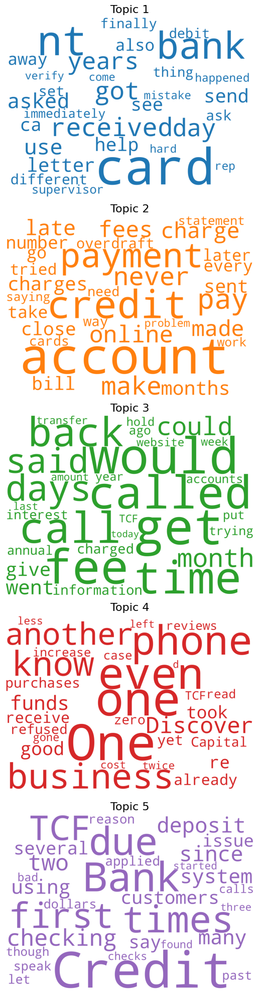

In [ ]:
from matplotlib import pyplot as plt
from wordcloud import WordCloud, STOPWORDS
import matplotlib.colors as mcolors

cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]

cloud = WordCloud(stopwords=stop_words,
                  background_color='white',
                  width=2500,
                  height=1800,
                  max_words=100,
                  colormap='tab10',
                  color_func=lambda *args, **kwargs: cols[i],
                  prefer_horizontal=1.0)

topics = lda_model.show_topics(formatted=False,
                               num_words=30)

fig, axes = plt.subplots(5, 1, figsize=(10,20), sharex=True, sharey=True)

for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics[i][1])
    cloud.generate_from_frequencies(topic_words, max_font_size=500)
    plt.gca().imshow(cloud)
    plt.gca().set_title('Topic ' + str(i + 1), fontdict=dict(size=16))
    plt.gca().axis('off')


plt.subplots_adjust(wspace=0, hspace=0)
plt.axis('off')
plt.margins(x=0, y=0)
plt.tight_layout()
plt.show()

## Analysing Influential Author's Review
By observing the dataset we categorize the influential authors as thos having more than 5o likes on their reviews

In [ ]:
! pip install rake_nltk

In [11]:
import spacy
from rake_nltk import Rake

In [34]:
dataset_df.head()

,author,date,location,bank,star,text,like
0,Kyle,31.08.2023,"Magnolia, TX",merrick_bank,5,Very easy to use to view statements and make o...,NaN
1,Julicia,23.08.2023,"Columbus, GA",merrick_bank,5,Merrick Bank has always been good to me for bu...,NaN
2,Karen,2.06.2023,"Marrero, LA",merrick_bank,4,Times are tough for everyone and I have worked...,3.0
3,Brent,29.03.2023,"Moultrie, GA",merrick_bank,5,I can not asked for a better Credit Card Compa...,3.0
4,Sharon,23.11.2022,"Burnham, IL",merrick_bank,5,Updated on 02/10/2023: I was happy to sign for...,3.0


In [39]:
likes_count = sum(1 for like_value in dataset_df['like'] if like_value > 40)

# Print the frequency
print(f"Frequency of likes more than 40: {likes_count}")

Frequency of likes more than 50: 153


We have 153 authors categorized as influential.We will apply keyword extraction techniques to understand the sentiment of the text.

### TF-IDF Method

In [18]:
import re

In [12]:
# Text Preprocessing

filtered_df = dataset_df[(dataset_df['like'] >= 40) & ((dataset_df['star'] == 1) | (dataset_df['star'] == 2))].dropna()
influence_text=filtered_df['text']

In [54]:
influence_text

716      I was sent a piece of mail saying I could rebu...
782      I received a pre-APPROVED card offer in the ma...
785      I have had a card from Merrick Bank for 3 year...
806      Back in November I was notified that my credit...
866      Pissed off Customer who was literally lied to ...
                               ...                        
19151    What is going on?! New website is full of inef...
19153    The digital banking is a DISASTER. For two day...
19155    The customer service is horrible. The overdraf...
19158    The dollar amounts in the app are never correc...
19160    I applied for a PPP Loan weeks ago to keep and...
Name: text, Length: 153, dtype: object

In [ ]:
def preprocess_text(text):
    # Convert text to lowercase
    text = text.lower()
    # Remove special characters
    text = re.sub(r'[^a-zA-Z\s]', '', text)
    # Tokenize the text
    tokens = nltk.word_tokenize(text)
    # Remove stopwords
    stop_words = set(stopwords.words('english'))
    filtered_tokens = [word for word in tokens if word not in stop_words]
    # Join the tokens back into a string
    preprocessed_text = ' '.join(filtered_tokens)
    return preprocessed_text

# Apply preprocessing to each text in 'filtered_df'
cleaned_text = influence_text.apply(preprocess_text)

# Print the preprocessed text
print(cleaned_text)

In [61]:
print(type(cleaned_text))

<class 'pandas.core.series.Series'>


In [77]:
#converted to list
updated_text = [cleaned_text.tolist()]

In [ ]:
updated_text

In [39]:
cleaned_text_str = cleaned_text.str.cat(sep=' ')

### NER Model

In [40]:
nlp = spacy.load("en_core_web_sm")

# Process the text with spaCy
doc = nlp(cleaned_text_str)

# Extract named entities from the text
entities = [(ent.text, ent.label_) for ent in doc.ents]

# Print the extracted keywords and named entities

print("Named Entities:", entities)

Named Entities: [('years', 'DATE'), ('first', 'ORDINAL'), ('november', 'DATE'), ('today', 'DATE'), ('card merrick bank', 'ORG'), ('year ago', 'DATE'), ('one', 'CARDINAL'), ('one', 'CARDINAL'), ('weeks', 'DATE'), ('day', 'DATE'), ('days', 'DATE'), ('months', 'DATE'), ('merrick bank week', 'ORG'), ('weeks', 'DATE'), ('month', 'DATE'), ('last months', 'DATE'), ('months', 'DATE'), ('every month months', 'DATE'), ('one', 'CARDINAL'), ('five', 'CARDINAL'), ('month', 'DATE'), ('month', 'DATE'), ('millions', 'CARDINAL'), ('last month', 'DATE'), ('one', 'CARDINAL'), ('year jan', 'DATE'), ('late fee months', 'DATE'), ('months', 'DATE'), ('day every month', 'DATE'), ('annual', 'DATE'), ('weeks months', 'DATE'), ('third fourth wednesday month', 'DATE'), ('second', 'ORDINAL'), ('two', 'CARDINAL'), ('late years ago', 'DATE'), ('months', 'DATE'), ('every month', 'DATE'), ('one day', 'DATE'), ('one', 'CARDINAL'), ('several months', 'DATE'), ('today', 'DATE'), ('merrick bank', 'ORG'), ('info', 'PERSON'

In [41]:
product_org_entities = [(ent.text, ent.label_) for ent in doc.ents if ent.label_ in {"PRODUCT", "ORG"}]

# Print the extracted product and organization entities
print("Product and Organization Entities:")
for entity, label in product_org_entities:
    print(f"{entity}: {label}")

Product and Organization Entities:
card merrick bank: ORG
merrick bank week: ORG
merrick bank: ORG
hsbc: ORG
hsbc: ORG
keybank: ORG
us bank: ORG
wells fargo let court: ORG
sue flagstar bank: ORG
wells fargo: ORG
navy: ORG
va loan navy federal credit union: ORG
fed: ORG
ltv navy: ORG
navy: ORG
card bank america: ORG
america comenity bank transition: ORG
switch bank america: ORG
fraud department: ORG
citibank: ORG
citibank: ORG
citibank: ORG
financial mastercard: ORG
year send snail: ORG
info credit cards: ORG
sofi promotion penny hoarder: ORG
money account bank dollars: ORG
sec: ORG
fbi: ORG
cit: ORG
cit bank: ORG
chemical bank: ORG
aaanndd: ORG


In [84]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [92]:
flattened_text = [text for sublist in updated_text for text in sublist]

In [112]:
tfidf_vectorizer = TfidfVectorizer(max_df=0.6, min_df=2, stop_words='english')
tfidf_matrix = tfidf_vectorizer.fit_transform(flattened_text)
feature_names = tfidf_vectorizer.get_feature_names_out()
tfidf_scores = tfidf_matrix.toarray()

# Extract keywords based on TF-IDF scores
tfidf_keywords = []
for i, review in enumerate(updated_text):
    review_keywords = [feature_names[idx] for idx in tfidf_scores[i].argsort()[-20:][::-1]]  # Extract top 5 keywords
    tfidf_keywords.append(review_keywords)

* Below are the keywords less frequent but can give some imporatant or critical information,for example we the usage of word 'Scam', 'Rates', 'application', indicating areas of improvement which are of immediate importance









In [113]:
review_keywords

['rebuild',
 'credit',
 'mail',
 'send',
 'ding',
 'agree',
 'letting',
 'simply',
 'applying',
 'application',
 'approval',
 'denied',
 'mean',
 'preapproved',
 'extremely',
 'rates',
 'scam',
 'stating',
 'thing',
 'high']

In [104]:
def frequent_words(reviews, n=20, ngram=1):
    tokens = nltk.word_tokenize(reviews.lower())
    if ngram == 1:
        grams = tokens
    elif ngram == 2:
        grams = list(ngrams(tokens, 2))
    elif ngram == 3:
        grams = list(ngrams(tokens, 3))
    elif ngram == 4:
        grams = list(ngrams(tokens, 4))

    freq_dist = Counter(grams)
    top_n = freq_dist.most_common(n)
    return top_n

# Filter dataset for ratings 1 and 2
#reviews_rating_1_2 = ' '.join(review['text'] for review in dataset_df if review['star'] in [1, 2])

# Get the most frequent words, bi-grams, and tri-grams for ratings 1 and 2
top_words = frequent_words(cleaned_text_str, n=20, ngram=1)
top_bi_grams = frequent_words(cleaned_text_str, n=20, ngram=2)
top_tri_grams = frequent_words(cleaned_text_str, n=20, ngram=3)
top_quad_grams= frequent_words(cleaned_text_str, n=20, ngram=4)

# Convert the results into a presentable table format
top_words_table = tabulate(top_words, headers=['Word', 'Frequency'], tablefmt='grid')
top_bi_grams_table = tabulate(top_bi_grams, headers=['Bi-gram', 'Frequency'], tablefmt='grid')
top_tri_grams_table = tabulate(top_tri_grams, headers=['Tri-gram', 'Frequency'], tablefmt='grid')
top_quad_grams_table = tabulate(top_quad_grams, headers=['Tri-gram', 'Frequency'], tablefmt='grid')

# Print the tables
print("Top 10 frequent words for ratings 1 and 2:")
print(top_words_table)
print("\nTop 10 frequent bi-grams for ratings 1 and 2:")
print(top_bi_grams_table)
print("\nTop 10 frequent tri-grams for ratings 1 and 2:")
print(top_tri_grams_table)
print("\nTop 10 frequent quad-grams for ratings 1 and 2:")
print(top_quad_grams_table)

Top 10 frequent words for ratings 1 and 2:
+----------+-------------+
| Word     |   Frequency |
+==========+=============+
| account  |         165 |
+----------+-------------+
| bank     |         112 |
+----------+-------------+
| money    |         105 |
+----------+-------------+
| card     |          93 |
+----------+-------------+
| credit   |          84 |
+----------+-------------+
| one      |          77 |
+----------+-------------+
| get      |          68 |
+----------+-------------+
| time     |          58 |
+----------+-------------+
| customer |          55 |
+----------+-------------+
| service  |          51 |
+----------+-------------+
| payment  |          48 |
+----------+-------------+
| never    |          47 |
+----------+-------------+
| call     |          47 |
+----------+-------------+
| company  |          46 |
+----------+-------------+
| would    |          43 |
+----------+-------------+
| called   |          43 |
+----------+-------------+
| loan     |

* Here we can observe the frequent words used by influential author
* This indicate some major customer grievances which other latent customer also agrees with.
* Important keyword observed are: 'Hostage', 'hacked', 'Rebuild', 'hard earned money', 'Credit card'

### Using Bertopic for Topic Modeling

In [ ]:
!pip install bertopic

In [ ]:
from bertopic import BERTopic

In [ ]:
model = BERTopic(verbose=True,embedding_model='paraphrase-MiniLM-L3-v2', min_topic_size= 9)
headline_topics, _ = model.fit_transform(cleaned_text)

In [26]:
freq = model.get_topic_info()
print("Number of topics: {}".format( len(freq)))
freq.head()

Number of topics: 5


,Topic,Count,Name,Representation,Representative_Docs
0,-1,13,-1_citibank_aaa_comenity_account,"[citibank, aaa, comenity, account, bank, call,...",[ive aaa visa card holder years recently aaa i...
1,0,108,0_account_credit_money_bank,"[account, credit, money, bank, card, one, paym...",[card merrick bank years never late payment re...
2,1,13,1_loan_nfcu_mortgage_officer,"[loan, nfcu, mortgage, officer, process, close...",[use nfcu mortgage loan regardless rates decid...
3,2,11,2_card_money_unemployment_bank,"[card, money, unemployment, bank, hours, hold,...",[absolutely terrible phone three days trying g...
4,3,8,3_tcf_time_call_dont,"[tcf, time, call, dont, money, bank, service, ...",[youre issues tcf debit card accessing account...


In [32]:
model.visualize_barchart(top_n_topics=10)

### Search Topics

In [48]:
similar_topics, similarity = model.find_topics("transfer", top_n = 3)

In [49]:
most_similar = similar_topics[0]
print("Most Similar Topic Info: \n{}".format(model.get_topic(most_similar)))
print("Similarity Score: {}".format(similarity[0]))

Most Similar Topic Info: 
[('account', 0.0822647062184043), ('money', 0.06723984615843691), ('sofi', 0.04649633598722161), ('funds', 0.037532239925828784), ('accounts', 0.03310536907701211), ('back', 0.031489313112140226), ('would', 0.03144711964412303), ('company', 0.03088696957306951), ('voya', 0.029192609490267116), ('day', 0.029115592599660626)]
Similarity Score: 0.23048534989356995
